## Exploring Singapore Neighborhoods

In this project, we'll be exploring the city state, Singapore, and attempting to perform a clustering of neighborhoods, in hopes that this information may be useful for any young adults looking to buy an aparmtment in future. Price will not be a factor and instead location will be.

Data will be gotten from data.gov.sg datasets and from Foursquare Places API. Subsequently we'll be clustering neighborhoods with K-means clustering.

In [12]:
import numpy as np
import pandas as pd
pd.set_option('display.max_columns', None)
pd.set_option('display.max_rows', None)
import geopandas as gpd
from geopy.geocoders import Nominatim
import folium

import json
import requests
from bs4 import BeautifulSoup as bs

from sklearn.cluster import KMeans
from sklearn.preprocessing import StandardScaler

import matplotlib.pyplot as plt
%matplotlib inline
print('Libraries imported.')

Libraries imported.


### Data Preprocessing: loading geojson file for neighborhood boundaries
First, let's get the geographical co-ordinates of Singapore in order to create a base map from folium

In [97]:
geolocator = Nominatim(user_agent="foursquare_agent")
location = geolocator.geocode("Singapore")
lat, long = location.latitude, location.longitude
sg_map = folium.Map(location = [lat, long], zoom_start=11.5, tiles="")

Next, we'll import the zone boundaries from Data.gov.sg's dataset. This will aid us in creation of a choropleth map subsequently. The data can be gotten from <a href="https://data.gov.sg/dataset/master-plan-2019-subzone-boundary-no-sea?resource_id=84b62d90-c1b7-4ada-acfc-f5874b5fd945">here</a>.

In [14]:
sg_geo_file = r'Data/master-plan-2019-subzone-boundary-no-sea-geojson.geojson'
sg_geo_df = gpd.read_file(sg_geo_file)
pd.set_option('display.max_rows', 10)
sg_geo_df

,Name,Description,geometry
0,kml_1,<center><table><tr><th colspan='2' align='cent...,"POLYGON Z ((103.88025 1.28386 0.00000, 103.880..."
1,kml_2,<center><table><tr><th colspan='2' align='cent...,"POLYGON Z ((103.83764 1.29560 0.00000, 103.837..."
2,kml_3,<center><table><tr><th colspan='2' align='cent...,"POLYGON Z ((103.83410 1.29248 0.00000, 103.834..."
3,kml_4,<center><table><tr><th colspan='2' align='cent...,"MULTIPOLYGON Z (((103.71253 1.29163 0.00000, 1..."
4,kml_5,<center><table><tr><th colspan='2' align='cent...,"POLYGON Z ((103.84718 1.29700 0.00000, 103.847..."
...,...,...,...
327,kml_328,<center><table><tr><th colspan='2' align='cent...,"POLYGON Z ((103.84263 1.36323 0.00000, 103.842..."
328,kml_329,<center><table><tr><th colspan='2' align='cent...,"POLYGON Z ((103.83537 1.37093 0.00000, 103.835..."
329,kml_330,<center><table><tr><th colspan='2' align='cent...,"POLYGON Z ((103.84814 1.36879 0.00000, 103.848..."
330,kml_331,<center><table><tr><th colspan='2' align='cent...,"POLYGON Z ((103.84652 1.34521 0.00000, 103.846..."


In [15]:
pd.set_option('display.max_rows', None)
sg_geo_df.iloc[0,1]

'<center><table><tr><th colspan=\'2\' align=\'center\'><em>Attributes</em></th></tr><tr bgcolor="#E3E3F3"> <th>SUBZONE_NO</th> <td>1</td> </tr><tr bgcolor=""> <th>SUBZONE_N</th> <td>MARINA EAST</td> </tr><tr bgcolor="#E3E3F3"> <th>SUBZONE_C</th> <td>MESZ01</td> </tr><tr bgcolor=""> <th>CA_IND</th> <td>Y</td> </tr><tr bgcolor="#E3E3F3"> <th>PLN_AREA_N</th> <td>MARINA EAST</td> </tr><tr bgcolor=""> <th>PLN_AREA_C</th> <td>ME</td> </tr><tr bgcolor="#E3E3F3"> <th>REGION_N</th> <td>CENTRAL REGION</td> </tr><tr bgcolor=""> <th>REGION_C</th> <td>CR</td> </tr><tr bgcolor="#E3E3F3"> <th>INC_CRC</th> <td>4FB7E5B1B9455DE0</td> </tr><tr bgcolor=""> <th>FMEL_UPD_D</th> <td>20191223152313</td> </tr></table></center>'

Which would appear as follows:
<center><table><tr><th colspan=\'2\' align=\'center\'><em>Attributes</em></th></tr><tr bgcolor="#E3E3F3"> <th>SUBZONE_NO</th> <td>1</td> </tr><tr bgcolor=""> <th>SUBZONE_N</th> <td>MARINA EAST</td> </tr><tr bgcolor="#E3E3F3"> <th>SUBZONE_C</th> <td>MESZ01</td> </tr><tr bgcolor=""> <th>CA_IND</th> <td>Y</td> </tr><tr bgcolor="#E3E3F3"> <th>PLN_AREA_N</th> <td>MARINA EAST</td> </tr><tr bgcolor=""> <th>PLN_AREA_C</th> <td>ME</td> </tr><tr bgcolor="#E3E3F3"> <th>REGION_N</th> <td>CENTRAL REGION</td> </tr><tr bgcolor=""> <th>REGION_C</th> <td>CR</td> </tr><tr bgcolor="#E3E3F3"> <th>INC_CRC</th> <td>4FB7E5B1B9455DE0</td> </tr><tr bgcolor=""> <th>FMEL_UPD_D</th> <td>20191223152313</td> </tr></table></center>

From the above, we see that the name of subzone is contained within the description column. To be more specific, it's the second \<td> item. As such, we use BeautifulSoup to help us retrieve the name of subzone and overwrite the Name column with it. After all, kml_i is not exactly a meaningful name for most, if not all, Singaporeans.

In [27]:
sg_geo_df['Name'] = sg_geo_df.apply(lambda row: (bs(row.Description)).find_all('td')[1].text.title() ,axis=1) 
sg_geo_df.rename(columns={'Name':'Neighborhood'}, inplace=True)
sg_geo_df.head()

,Neighborhood,Description,geometry
0,Marina East,<center><table><tr><th colspan='2' align='cent...,"POLYGON Z ((103.88025 1.28386 0.00000, 103.880..."
1,Institution Hill,<center><table><tr><th colspan='2' align='cent...,"POLYGON Z ((103.83764 1.29560 0.00000, 103.837..."
2,Robertson Quay,<center><table><tr><th colspan='2' align='cent...,"POLYGON Z ((103.83410 1.29248 0.00000, 103.834..."
3,Jurong Island And Bukom,<center><table><tr><th colspan='2' align='cent...,"MULTIPOLYGON Z (((103.71253 1.29163 0.00000, 1..."
4,Fort Canning,<center><table><tr><th colspan='2' align='cent...,"POLYGON Z ((103.84718 1.29700 0.00000, 103.847..."


### Data Preprocessing: to get the resident population and estimated average age of each neighborhood
We utilize a second dataset, from Data.gov.sg, which will inform us on the resident population in each neighborhood by age group and gender, as of 2015. To be more specific, this dataset is actually a composite of 4 datasets in the following order:
1. Total Resident Count in each subzone
2. Total Resident Count in each subzone, with a further breakdown on age group
3. Total Resident Count in each subzone, with a further breakdown on sex
4. Total Resident Count in each subzone, witha further breakdown on age group and sex

As such, we'll extract the first and second. The first will be used as a proxy for how many people are living in a neighborhood, and the second will be used to help us estimate the average age of residents in a neighborhood. According to Singapore Department of Statistics, Singapore Residents refer to Singapore citizens and permanent residents. So unfortunately, this dataset does not have information on non-residents, a group which approximately accounts for 30% of the total population. (https://www.singstat.gov.sg/find-data/search-by-theme/population/population-and-population-structure/latest-data)

In [74]:
sg_resident_df = pd.read_csv("Data/resident-population-by-subzone-age-group-and-sex.csv")
sg_resident_df.drop(columns=['year'],inplace=True)
sg_resident_df.columns=['Sex', 'AgeGroup', 'PlanningArea','Neighborhood','ResidentCount']
sg_resident_df.head()

,Sex,AgeGroup,PlanningArea,Neighborhood,ResidentCount
0,Total,Total,Ang Mo Kio- Total,Ang Mo Kio Town Centre,5020
1,Total,Total,Ang Mo Kio- Total,Cheng San,29770
2,Total,Total,Ang Mo Kio- Total,Chong Boon,27900
3,Total,Total,Ang Mo Kio- Total,Kebun Bahru,23910
4,Total,Total,Ang Mo Kio- Total,Sembawang Hills,6890


In [31]:
totalcount_df = sg_resident_df[(sg_resident_df['Sex'] == 'Total') & (sg_resident_df['AgeGroup'] == 'Total')]
totalcount_df.shape

(281, 5)

In [33]:
totalcount_df['ResidentCount'].sum()

3902840

We can observe that the number of rows (282) is actually less than the 332 neighborhoods in our earlier dataset. In fact, it would be more accurate to call them subzones of Singapore. Not all subzones are designated residential areas, and some, such as industrial areas, will not be conducive for living. In fact, we will further exclude analysis of areas with resident counts below 200.

In [37]:
pd.options.mode.chained_assignment = None
totalcount_df['ResidentCount'] = totalcount_df['ResidentCount'].map(lambda x: np.nan if (x < 200) else x)
totalcount_df[totalcount_df['ResidentCount'] < 200]

,Sex,AgeGroup,PlanningArea,Neighborhood,ResidentCount


##### Extracting Resident Count in each subzone, broken down by age group

Let's pivot on age group. Sex and PlanningArea can be dropped from, as only the neighborhood is of interest

In [54]:
count_byagegroup_df = sg_resident_df[(sg_resident_df['Sex'] == 'Total') & (sg_resident_df['AgeGroup'] != 'Total')]
count_byagegroup_df.drop(columns=['Sex', 'PlanningArea'],inplace=True)
count_byagegroup_df.shape

(4037, 3)

In [55]:
count_byagegroup_df.head()

,AgeGroup,Neighborhood,ResidentCount
281,0 - 4,Ang Mo Kio Town Centre,260
282,0 - 4,Cheng San,1290
283,0 - 4,Chong Boon,910
284,0 - 4,Kebun Bahru,780
285,0 - 4,Sembawang Hills,200


In [59]:
def getTotalAge(row):
    if row.ResidentCount == np.nan:
        return 0
    if row.AgeGroup == '85 & Over':
        avg_age = 87
    else:
        ages = (row.AgeGroup).split(" - ")
        avg_age = (int(ages[0]) + int(ages[1]))//2
    return row.ResidentCount * avg_age

In [60]:
count_byagegroup_df['TotalAge'] = count_byagegroup_df.apply(lambda row: getTotalAge(row), axis=1)
count_byagegroup_df.head()

,AgeGroup,Neighborhood,ResidentCount,TotalAge
281,0 - 4,Ang Mo Kio Town Centre,260,520
282,0 - 4,Cheng San,1290,2580
283,0 - 4,Chong Boon,910,1820
284,0 - 4,Kebun Bahru,780,1560
285,0 - 4,Sembawang Hills,200,400


In [65]:
totalage_df = count_byagegroup_df.groupby(['Neighborhood'],sort=False)[['TotalAge']].agg('sum')
totalage_df.head()

,TotalAge
Neighborhood,
Ang Mo Kio Town Centre,194790
Cheng San,1246610
Chong Boon,1210640
Kebun Bahru,1028390
Sembawang Hills,280570


In [68]:
totalcount_df = totalcount_df.join(totalage_df, on='Neighborhood')

# if ResidentCount has been marked as NaN, AvgAge will be denoted as Nan similarly
totalcount_df['AvgAge'] = totalcount_df.apply(lambda row: round((row.TotalAge)/(row.ResidentCount), 2), axis=1) 

totalcount_df.drop(columns=['TotalAge','Sex','AgeGroup','PlanningArea'], inplace=True)
totalcount_df.head()

,Sex,AgeGroup,PlanningArea,Neighborhood,ResidentCount,AvgAge
0,Total,Total,Ang Mo Kio- Total,Ang Mo Kio Town Centre,5020.0,38.80
1,Total,Total,Ang Mo Kio- Total,Cheng San,29770.0,41.87
2,Total,Total,Ang Mo Kio- Total,Chong Boon,27900.0,43.39
3,Total,Total,Ang Mo Kio- Total,Kebun Bahru,23910.0,43.01
4,Total,Total,Ang Mo Kio- Total,Sembawang Hills,6890.0,40.72


In [95]:
sg_geo_df = pd.merge(sg_geo_df, totalcount_df, on='Neighborhood', how='left')
sg_geo_df.head()


,Neighborhood,Description,geometry,ResidentCount,AvgAge
0,Marina East,<center><table><tr><th colspan='2' align='cent...,"POLYGON Z ((103.88025 1.28386 0.00000, 103.880...",NaN,NaN
1,Institution Hill,<center><table><tr><th colspan='2' align='cent...,"POLYGON Z ((103.83764 1.29560 0.00000, 103.837...",3380.0,36.68
2,Robertson Quay,<center><table><tr><th colspan='2' align='cent...,"POLYGON Z ((103.83410 1.29248 0.00000, 103.834...",2420.0,36.67
3,Jurong Island And Bukom,<center><table><tr><th colspan='2' align='cent...,"MULTIPOLYGON Z (((103.71253 1.29163 0.00000, 1...",NaN,NaN
4,Fort Canning,<center><table><tr><th colspan='2' align='cent...,"POLYGON Z ((103.84718 1.29700 0.00000, 103.847...",NaN,NaN


#### Visualizing Distribution of resident population and average age across neighborhoods

In [125]:
folium.Choropleth(
    geo_data=sg_geo_df,
    name='Choropleth Map of Singapore by Resident Count',
    data=sg_geo_df,
    columns=['Neighborhood', 'ResidentCount'],
    key_on='feature.properties.Neighborhood',
    fill_color='Reds',
    fill_opacity=0.7,
    line_opacity=0.2,
    legend_name='Resident Count',
    highlight=True,
    line_color='Black',
    nan_fill_color = "White"
).add_to(sg_map)
sg_map

For someone who isn't as geog-savvy, they wouldn't know where's where, so let's add in some tooltips.

In [132]:
style_function = lambda x: {'fillColor': '#ffffff', 
                            'color':'#000000', 
                            'fillOpacity': 0.1, 
                            'weight': 0.1}
highlight_function = lambda x: {'fillColor': '#000000', 
                                'color':'#000000', 
                                'fillOpacity': 0.50, 
                                'weight': 0.1}
folium.features.GeoJson(data = sg_geo_df,
                        style_function=style_function,
                        highlight_function=highlight_function,
                        tooltip=folium.features.GeoJsonTooltip(
                            fields=['Neighborhood','ResidentCount','AvgAge'],
                            aliases=['Neighborhood','Population','Estimated avg. age'],
                            style=("background-color: white; color: #333333; font-family: arial; font-size: 12px; padding: 10px;")
                            )
                       ).add_to(sg_map)
sg_map

In [133]:
sg_map.save("sg_map_residentcount.html")

Let's create 1 more choropleth map by estimated avg age.

In [135]:
sg_age_map = folium.Map(location = [lat, long], zoom_start=11.5, tiles="")
folium.Choropleth(
    geo_data=sg_geo_df,
    name='Choropleth Map of Singapore by Estimated Avg Age',
    data=sg_geo_df,
    columns=['Neighborhood', 'AvgAge'],
    key_on='feature.properties.Neighborhood',
    fill_color='Reds',
    fill_opacity=0.7,
    line_opacity=0.2,
    legend_name='Estimated Avg Age',
    highlight=True,
    line_color='Black',
    nan_fill_color = "White"
).add_to(sg_age_map)
folium.features.GeoJson(data = sg_geo_df,
                        style_function=style_function,
                        highlight_function=highlight_function,
                        tooltip=folium.features.GeoJsonTooltip(
                            fields=['Neighborhood','ResidentCount','AvgAge'],
                            aliases=['Neighborhood','Population','Estimated avg. age'],
                            style=("background-color: white; color: #333333; font-family: arial; font-size: 12px; padding: 10px;")
                            )
                       ).add_to(sg_age_map)
sg_age_map

In [136]:
sg_map.save("sg_map_estAvgAge.html")

### Data Preprocessing: Retrieving coordinates of each neighborhood and nearby venues

Next, we move on to finding venues within 1km of each neighborhood centre. But to facilitate this search, we'll first need to find the coords of each neighborhood.

In [104]:
def find_coords(zone):
    location = geolocator.geocode(f"{zone}, Singapore")
    if location is None:
        return (np.nan, np.nan)
    return (location.latitude, location.longitude)

In [106]:
sg_geo_df['Coords'] = sg_geo_df.apply(lambda row: find_coords(row.Neighborhood),axis=1)
sg_geo_df.head()

,Neighborhood,Description,geometry,ResidentCount,AvgAge,Coords
0,Marina East,<center><table><tr><th colspan='2' align='cent...,"POLYGON Z ((103.88025 1.28386 0.00000, 103.880...",NaN,NaN,"(1.288624, 103.869827)"
1,Institution Hill,<center><table><tr><th colspan='2' align='cent...,"POLYGON Z ((103.83764 1.29560 0.00000, 103.837...",3380.0,36.68,"(1.2957879, 103.8400834)"
2,Robertson Quay,<center><table><tr><th colspan='2' align='cent...,"POLYGON Z ((103.83410 1.29248 0.00000, 103.834...",2420.0,36.67,"(1.2917517, 103.8413036)"
3,Jurong Island And Bukom,<center><table><tr><th colspan='2' align='cent...,"MULTIPOLYGON Z (((103.71253 1.29163 0.00000, 1...",NaN,NaN,"(nan, nan)"
4,Fort Canning,<center><table><tr><th colspan='2' align='cent...,"POLYGON Z ((103.84718 1.29700 0.00000, 103.847...",NaN,NaN,"(1.2923829, 103.8442419564924)"


In [151]:
sg_geo_df['Latitude'], sg_geo_df['Longitude'] = zip(*sg_geo_df.apply(lambda row: row.Coords, axis=1))
sg_geo_df.head()

,Neighborhood,Description,geometry,ResidentCount,AvgAge,Coords,Latitude,Longitude
0,Marina East,<center><table><tr><th colspan='2' align='cent...,"POLYGON Z ((103.88025 1.28386 0.00000, 103.880...",NaN,NaN,"(1.288624, 103.869827)",1.288624,103.869827
1,Institution Hill,<center><table><tr><th colspan='2' align='cent...,"POLYGON Z ((103.83764 1.29560 0.00000, 103.837...",3380.0,36.68,"(1.2957879, 103.8400834)",1.295788,103.840083
2,Robertson Quay,<center><table><tr><th colspan='2' align='cent...,"POLYGON Z ((103.83410 1.29248 0.00000, 103.834...",2420.0,36.67,"(1.2917517, 103.8413036)",1.291752,103.841304
3,Jurong Island And Bukom,<center><table><tr><th colspan='2' align='cent...,"MULTIPOLYGON Z (((103.71253 1.29163 0.00000, 1...",NaN,NaN,"(nan, nan)",NaN,NaN
4,Fort Canning,<center><table><tr><th colspan='2' align='cent...,"POLYGON Z ((103.84718 1.29700 0.00000, 103.847...",NaN,NaN,"(1.2923829, 103.8442419564924)",1.292383,103.844242


Let's take a look to see if there are any areas whose coordinates couldn't be found.

In [152]:
sg_geo_df[sg_geo_df['Longitude'].isnull() & sg_geo_df['ResidentCount'].notnull()]

,Neighborhood,Description,geometry,ResidentCount,AvgAge,Coords,Latitude,Longitude
23,Central Subzone,<center><table><tr><th colspan='2' align='cent...,"POLYGON Z ((103.85521 1.28322 0.00000, 103.855...",480.0,37.88,"(nan, nan)",NaN,NaN
171,Kebun Bahru,<center><table><tr><th colspan='2' align='cent...,"POLYGON Z ((103.83773 1.37711 0.00000, 103.838...",23910.0,43.01,"(nan, nan)",NaN,NaN
176,Wenya,<center><table><tr><th colspan='2' align='cent...,"POLYGON Z ((103.70616 1.34774 0.00000, 103.705...",8610.0,33.07,"(nan, nan)",NaN,NaN
239,Peng Siang,<center><table><tr><th colspan='2' align='cent...,"POLYGON Z ((103.74235 1.37620 0.00000, 103.741...",32130.0,36.70,"(nan, nan)",NaN,NaN


Since it's just 4 locations, we will manually search for the coords as follows. Note that Central subzone is too general, so I've used Marina Bay MRT as the coords for it.

In [153]:
sg_geo_df.iloc[23,-2:] = (1.2760628,103.8527015)
sg_geo_df.iloc[171,-2:] = (1.2762388,103.7848501)
sg_geo_df.iloc[176,-2:] = (1.3537778,103.7013693)
sg_geo_df.iloc[239,-2:] = (1.383451,103.7340655)

Now, we are ready to feed the coordinates into Foursquare Places API.

In [154]:
# Specifying Foursquare API Credentials, api ID and secret are veiled in a separate file called config

from config import credentials
CLIENT_ID = credentials['id']
CLIENT_SECRET = credentials['secret']
VERSION = '20210625' # Foursquare API version
LIMIT = 100 # A default Foursquare API limit value

In [159]:
def getNearbyVenues(names, latitudes, longitudes, radius=1000):
    
    venues_list=[]
    for name, lat, lng in zip(names, latitudes, longitudes):
        # create the API request URL
        url = 'https://api.foursquare.com/v2/venues/explore?&client_id={}&client_secret={}&v={}&ll={},{}&radius={}&limit={}'.format(
            CLIENT_ID, 
            CLIENT_SECRET, 
            VERSION, 
            lat, 
            lng, 
            radius, 
            LIMIT)
            
        # make the GET request
        results = requests.get(url).json()["response"]['groups'][0]['items']
        
        # return only relevant information for each nearby venue
        venues_list.append([(
            name, 
            lat, 
            lng, 
            v['venue']['name'], 
            v['venue']['location']['lat'], 
            v['venue']['location']['lng'],  
            v['venue']['categories'][0]['name']) for v in results])

    nearby_venues = pd.DataFrame([item for venue_list in venues_list for item in venue_list])
    nearby_venues.columns = ['Neighborhood', 
                  'Neighborhood Latitude', 
                  'Neighborhood Longitude', 
                  'Venue', 
                  'Venue Latitude', 
                  'Venue Longitude', 
                  'Venue Category']
    return(nearby_venues)

We'll skip finding venues around areas which has no residents.

In [156]:
neighborhood_df = sg_geo_df[sg_geo_df['ResidentCount'].notnull() & sg_geo_df['Longitude'].notnull()]
neighborhood_df.shape

(214, 8)

In [160]:
print("Finding Venues...")
sg_venues = getNearbyVenues(names=neighborhood_df['Neighborhood'],
                            latitudes=neighborhood_df['Latitude'],
                            longitudes=neighborhood_df['Longitude']
                           )
print(".Search ended.")
print(f'Dimensions of sg_venues: {sg_venues.shape}')

Finding Venues...
.Search ended.
Dimensions of sg_venues: (12629, 7)


In [161]:
sg_venues.to_csv('sg_venues.csv',index=False)

In [162]:
sg_venues.head()

,Neighborhood,Neighborhood Latitude,Neighborhood Longitude,Venue,Venue Latitude,Venue Longitude,Venue Category
0,Institution Hill,1.295788,103.840083,Lloyd's Inn,1.297184,103.840464,Hotel
1,Institution Hill,1.295788,103.840083,Yakiniku YAZAWA,1.291828,103.842172,Japanese Restaurant
2,Institution Hill,1.295788,103.840083,Wine Connection Cheese Bar,1.292364,103.841789,Wine Bar
3,Institution Hill,1.295788,103.840083,Bistecca Tuscan Steakhouse,1.293149,103.841451,Steakhouse
4,Institution Hill,1.295788,103.840083,Hvala,1.300345,103.837880,Tea Room


In [164]:
len(sg_venues['Venue Category'].unique())

353

### Clustering of neighborhoods
Seems like Singapore truly is a bustling city state, we had capped the venues per neighborhood to be 100, and have gotten a total of 12629 venues across 214 neighborhoods. Among the venues, there are 353 unique categories. Next we move on to implementing K-means clustering. K-means clustering does not accept categorical values. As such, we'll use one-hot encoding on categories, turning it into 353 features corresponding to each unique category. Subsequently, we group venues by neighborhood since our clustering is meant to be done on each neighborhood, reducing the values to be the frequency of occurence of each category. A value of 0.2 for a category would mean that of the venes within the neighborhood, 20% are of said category.

In [211]:
# one hot encoding
sg_onehot = pd.get_dummies(sg_venues[['Venue Category']], prefix="", prefix_sep="")
sg_onehot.rename(columns={'Neighborhood':'Neighborhood Venue'},inplace=True)

# add neighborhood column back to dataframe, in order to groupby neighborhood when calculating mean
sg_onehot.insert(0, column='Neighborhood', value = sg_venues['Neighborhood']) 
sg_grouped = sg_onehot.groupby('Neighborhood').mean().reset_index()
sg_grouped.shape

(214, 354)

In [212]:
sg_grouped.head()

,Neighborhood,Accessories Store,Airport,Airport Lounge,Airport Service,Airport Terminal,American Restaurant,Aquarium,Arcade,Art Gallery,Art Museum,Arts & Crafts Store,Arts & Entertainment,Asian Restaurant,Athletics & Sports,Australian Restaurant,Auto Garage,Automotive Shop,BBQ Joint,Baby Store,Badminton Court,Bagel Shop,Bakery,Bar,Baseball Field,Baseball Stadium,Basketball Court,Basketball Stadium,Bay,Beach,Beach Bar,Bed & Breakfast,Beer Bar,Beer Garden,Betting Shop,Big Box Store,Bike Rental / Bike Share,Bike Trail,Bistro,Board Shop,Boarding House,Boat Launch,Boat or Ferry,Bookstore,Border Crossing,Botanical Garden,Boutique,Bowling Alley,Brazilian Restaurant,Breakfast Spot,Brewery,Bridge,Bubble Tea Shop,Buddhist Temple,Buffet,Building,Burger Joint,Burrito Place,Bus Line,Bus Station,Bus Stop,Butcher,Cable Car,Cafeteria,Café,Campground,Canal,Cantonese Restaurant,Caribbean Restaurant,Casino,Cha Chaan Teng,Chinese Aristocrat Restaurant,Chinese Breakfast Place,Chinese Restaurant,Chocolate Shop,Church,Climbing Gym,Clothing Store,Club House,Cocktail Bar,Coffee Shop,College Administrative Building,College Cafeteria,College Classroom,College Gym,College Residence Hall,College Theater,Comedy Club,Comfort Food Restaurant,Concert Hall,Convenience Store,Cosmetics Shop,Coworking Space,Cuban Restaurant,Cupcake Shop,Dance Studio,Deli / Bodega,Department Store,Dessert Shop,Dim Sum Restaurant,Diner,Discount Store,Dive Bar,Doctor's Office,Dog Run,Drugstore,Dumpling Restaurant,Electronics Store,Empanada Restaurant,English Restaurant,Event Space,Factory,Falafel Restaurant,Farm,Farmers Market,Fast Food Restaurant,Field,Filipino Restaurant,Fish & Chips Shop,Fish Market,Fishing Spot,Flea Market,Flower Shop,Food,Food & Drink Shop,Food Court,Food Stand,Food Truck,French Restaurant,Fried Chicken Joint,Frozen Yogurt Shop,Fruit & Vegetable Store,Fujian Restaurant,Furniture / Home Store,Gaming Cafe,Garden,Garden Center,Gas Station,Gastropub,Gelato Shop,General Entertainment,German Restaurant,Gift Shop,Go Kart Track,Golf Course,Golf Driving Range,Gourmet Shop,Government Building,Greek Restaurant,Grocery Store,Gym,Gym / Fitness Center,Gym Pool,Gymnastics Gym,Hainan Restaurant,Hakka Restaurant,Halal Restaurant,Harbor / Marina,Health & Beauty Service,Health Food Store,High School,Hill,Historic Site,History Museum,Hobby Shop,Hockey Arena,Hockey Field,Hong Kong Restaurant,Hookah Bar,Hospital,Hostel,Hot Dog Joint,Hot Spring,Hotel,Hotel Bar,Hotpot Restaurant,Housing Development,Ice Cream Shop,Indian Restaurant,Indonesian Restaurant,Indoor Play Area,Island,Italian Restaurant,Japanese Curry Restaurant,Japanese Restaurant,Jewelry Store,Juice Bar,Karaoke Bar,Kebab Restaurant,Kids Store,Kitchen Supply Store,Korean Restaurant,Lake,Latin American Restaurant,Laundromat,Light Rail Station,Lighthouse,Lighting Store,Lingerie Store,Lottery Retailer,Lounge,Macanese Restaurant,Malay Restaurant,Market,Martial Arts School,Massage Studio,Medical Center,Mediterranean Restaurant,Metro Station,Mexican Restaurant,Middle Eastern Restaurant,Military Base,Miscellaneous Shop,Mobile Phone Shop,Modern European Restaurant,Molecular Gastronomy Restaurant,Monument / Landmark,Mosque,Motel,Motorcycle Shop,Mountain,Movie Theater,Multiplex,Museum,Music School,Music Store,Music Venue,Nail Salon,Nature Preserve,Neighborhood Venue,New American Restaurant,Nightclub,Noodle House,North Indian Restaurant,Office,Optical Shop,Other Great Outdoors,Other Nightlife,Other Repair Shop,Outdoor Sculpture,Outdoors & Recreation,Outlet Store,Paella Restaurant,Paintball Field,Paper / Office Supplies Store,Park,Pedestrian Plaza,Peking Duck Restaurant,Performing Arts Venue,Persian Restaurant,Pet Service,Pet Store,Pharmacy,Photography Studio,Pie Shop,Pier,Pizza Place,Playground,Plaza,Pool,Pool Hall,Port,Portuguese Restaurant,Post Office,Pub,RV Park,Racetrack,Ramen Restaurant,Recreation Center,Reservoir,Residential Building (Apartment / Condo),Resort,Rest Area,Restaurant,River,Road,Rock Climbing Spot,Sake Bar,Salad Place

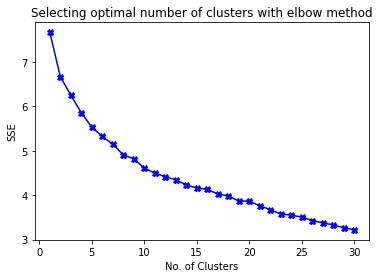

In [214]:
sg_cluster_df = sg_grouped.drop('Neighborhood', axis=1)
sse = []
for i in range(1,31):
    kmeans = KMeans(n_clusters=i, random_state=42, n_init=30).fit(sg_cluster_df)
    sse.append(kmeans.inertia_)
    
# Plot sse against no. of clusters
plt.plot(range(1,31), sse, color='b', marker='X', linestyle='-')
plt.xlabel('No. of Clusters')
plt.ylabel('SSE')
plt.title('Selecting optimal number of clusters with elbow method')
plt.show()

From the above graph, it is actually pretty hard to tell definitively where the elbow point but we'll select 8 as the optimal number of clusters.

In [218]:
kmeans = KMeans(n_clusters=8, random_state=42, n_init=30).fit(sg_cluster_df)
sg_grouped.insert(1, column='Cluster Label', value = kmeans.labels_) 
sg_grouped = sg_grouped.merge(neighborhood_df[['Neighborhood','ResidentCount','AvgAge','Latitude','Longitude']],
                              how="left", 
                              on='Neighborhood') 
sg_grouped.head()

,Neighborhood,Cluster Label,Accessories Store,Airport,Airport Lounge,Airport Service,Airport Terminal,American Restaurant,Aquarium,Arcade,Art Gallery,Art Museum,Arts & Crafts Store,Arts & Entertainment,Asian Restaurant,Athletics & Sports,Australian Restaurant,Auto Garage,Automotive Shop,BBQ Joint,Baby Store,Badminton Court,Bagel Shop,Bakery,Bar,Baseball Field,Baseball Stadium,Basketball Court,Basketball Stadium,Bay,Beach,Beach Bar,Bed & Breakfast,Beer Bar,Beer Garden,Betting Shop,Big Box Store,Bike Rental / Bike Share,Bike Trail,Bistro,Board Shop,Boarding House,Boat Launch,Boat or Ferry,Bookstore,Border Crossing,Botanical Garden,Boutique,Bowling Alley,Brazilian Restaurant,Breakfast Spot,Brewery,Bridge,Bubble Tea Shop,Buddhist Temple,Buffet,Building,Burger Joint,Burrito Place,Bus Line,Bus Station,Bus Stop,Butcher,Cable Car,Cafeteria,Café,Campground,Canal,Cantonese Restaurant,Caribbean Restaurant,Casino,Cha Chaan Teng,Chinese Aristocrat Restaurant,Chinese Breakfast Place,Chinese Restaurant,Chocolate Shop,Church,Climbing Gym,Clothing Store,Club House,Cocktail Bar,Coffee Shop,College Administrative Building,College Cafeteria,College Classroom,College Gym,College Residence Hall,College Theater,Comedy Club,Comfort Food Restaurant,Concert Hall,Convenience Store,Cosmetics Shop,Coworking Space,Cuban Restaurant,Cupcake Shop,Dance Studio,Deli / Bodega,Department Store,Dessert Shop,Dim Sum Restaurant,Diner,Discount Store,Dive Bar,Doctor's Office,Dog Run,Drugstore,Dumpling Restaurant,Electronics Store,Empanada Restaurant,English Restaurant,Event Space,Factory,Falafel Restaurant,Farm,Farmers Market,Fast Food Restaurant,Field,Filipino Restaurant,Fish & Chips Shop,Fish Market,Fishing Spot,Flea Market,Flower Shop,Food,Food & Drink Shop,Food Court,Food Stand,Food Truck,French Restaurant,Fried Chicken Joint,Frozen Yogurt Shop,Fruit & Vegetable Store,Fujian Restaurant,Furniture / Home Store,Gaming Cafe,Garden,Garden Center,Gas Station,Gastropub,Gelato Shop,General Entertainment,German Restaurant,Gift Shop,Go Kart Track,Golf Course,Golf Driving Range,Gourmet Shop,Government Building,Greek Restaurant,Grocery Store,Gym,Gym / Fitness Center,Gym Pool,Gymnastics Gym,Hainan Restaurant,Hakka Restaurant,Halal Restaurant,Harbor / Marina,Health & Beauty Service,Health Food Store,High School,Hill,Historic Site,History Museum,Hobby Shop,Hockey Arena,Hockey Field,Hong Kong Restaurant,Hookah Bar,Hospital,Hostel,Hot Dog Joint,Hot Spring,Hotel,Hotel Bar,Hotpot Restaurant,Housing Development,Ice Cream Shop,Indian Restaurant,Indonesian Restaurant,Indoor Play Area,Island,Italian Restaurant,Japanese Curry Restaurant,Japanese Restaurant,Jewelry Store,Juice Bar,Karaoke Bar,Kebab Restaurant,Kids Store,Kitchen Supply Store,Korean Restaurant,Lake,Latin American Restaurant,Laundromat,Light Rail Station,Lighthouse,Lighting Store,Lingerie Store,Lottery Retailer,Lounge,Macanese Restaurant,Malay Restaurant,Market,Martial Arts School,Massage Studio,Medical Center,Mediterranean Restaurant,Metro Station,Mexican Restaurant,Middle Eastern Restaurant,Military Base,Miscellaneous Shop,Mobile Phone Shop,Modern European Restaurant,Molecular Gastronomy Restaurant,Monument / Landmark,Mosque,Motel,Motorcycle Shop,Mountain,Movie Theater,Multiplex,Museum,Music School,Music Store,Music Venue,Nail Salon,Nature Preserve,Neighborhood Venue,New American Restaurant,Nightclub,Noodle House,North Indian Restaurant,Office,Optical Shop,Other Great Outdoors,Other Nightlife,Other Repair Shop,Outdoor Sculpture,Outdoors & Recreation,Outlet Store,Paella Restaurant,Paintball Field,Paper / Office Supplies Store,Park,Pedestrian Plaza,Peking Duck Restaurant,Performing Arts Venue,Persian Restaurant,Pet Service,Pet Store,Pharmacy,Photography Studio,Pie Shop,Pier,Pizza Place,Playground,Plaza,Pool,Pool Hall,Port,Portuguese Restaurant,Post Office,Pub,RV Park,Racetrack,Ramen Restaurant,Recreation Center,Reservoir,Residential Building (Apartment / Condo),Resort,Rest Area,Restaurant,River,Road,Rock Climbing Spot,Sake B

### Results
Here, we visualize the eventual cluster against Singapore map, and find the defining features of each cluster.

In [220]:
import matplotlib.cm as cm
import matplotlib.colors as colors

# create map
map_clusters = folium.Map(location=[lat, long], zoom_start=11.5)
kclusters = 8
# set color scheme for the clusters
x = np.arange(kclusters)
ys = [i + x + (i*x)**2 for i in range(kclusters)]
colors_array = cm.rainbow(np.linspace(0, 1, len(ys)))
rainbow = [colors.rgb2hex(i) for i in colors_array]

# add markers to the map
markers_colors = []
for lat, lon, poi, cluster in zip(sg_grouped['Latitude'], sg_grouped['Longitude'], sg_grouped['Neighborhood'], sg_grouped['Cluster Label']):
    label = folium.Popup(str(poi) + ' Cluster ' + str(cluster), parse_html=True)
    folium.CircleMarker(
        [lat, lon],
        radius=5,
        popup=label,
        color=rainbow[int(cluster)-1],
        fill=True,
        fill_color=rainbow[int(cluster)-1],
        fill_opacity=0.7).add_to(map_clusters)
       
map_clusters

In [221]:
def return_most_common_venues(row, num_top_venues):
    row_categories = row.iloc[1:]
    row_categories_sorted = row_categories.sort_values(ascending=False)
    
    return row_categories_sorted.index.values[0:num_top_venues]

In [224]:
num_top_venues = 10
sg_venues_only = sg_grouped.drop(columns=['Cluster Label','ResidentCount','AvgAge','Latitude','Longitude'])
indicators = ['st', 'nd', 'rd']

# create columns according to number of top venues
columns = ['Neighborhood']
for ind in np.arange(num_top_venues):
    try:
        columns.append('{}{} Most Common Venue'.format(ind+1, indicators[ind]))
    except:
        columns.append('{}th Most Common Venue'.format(ind+1))

# create a new dataframe
neighborhoods_venues_sorted = pd.DataFrame(columns=columns)
neighborhoods_venues_sorted['Neighborhood'] = sg_venues_only['Neighborhood']

for ind in np.arange(sg_venues_only.shape[0]):
    neighborhoods_venues_sorted.iloc[ind, 1:] = return_most_common_venues(sg_venues_only.iloc[ind, :], num_top_venues)

neighborhoods_venues_sorted.head()

,Neighborhood,1st Most Common Venue,2nd Most Common Venue,3rd Most Common Venue,4th Most Common Venue,5th Most Common Venue,6th Most Common Venue,7th Most Common Venue,8th Most Common Venue,9th Most Common Venue,10th Most Common Venue
0,Admiralty,Food Court,Park,Fast Food Restaurant,Bus Station,Supermarket,Coffee Shop,Dim Sum Restaurant,Halal Restaurant,School,Fish Market
1,Alexandra Hill,Chinese Restaurant,Food Court,Café,Coffee Shop,Fast Food Restaurant,Asian Restaurant,Bakery,Shopping Mall,Cocktail Bar,Thai Restaurant
2,Alexandra North,Chinese Restaurant,Food Court,Café,Coffee Shop,Fast Food Restaurant,Asian Restaurant,Bakery,Shopping Mall,Cocktail Bar,Thai Restaurant
3,Aljunied,Chinese Restaurant,Noodle House,Food Court,Asian Restaurant,Hotel,BBQ Joint,Dim Sum Restaurant,Vegetarian / Vegan Restaurant,Seafood Restaurant,Dessert Shop
4,Anak Bukit,Café,Korean Restaurant,Chinese Restaurant,Sandwich Place,Indian Restaurant,Supermarket,Food Court,Thai Restaurant,Coffee Shop,Noodle House


In [225]:
neighborhoods_venues_sorted.insert(1, column='Cluster Label', value = kmeans.labels_)

In [228]:
pd.set_option('display.max_rows', 6)

Cluster 0

In [229]:
neighborhoods_venues_sorted.loc[neighborhoods_venues_sorted['Cluster Label'] == 0]

,Neighborhood,Cluster Label,1st Most Common Venue,2nd Most Common Venue,3rd Most Common Venue,4th Most Common Venue,5th Most Common Venue,6th Most Common Venue,7th Most Common Venue,8th Most Common Venue,9th Most Common Venue,10th Most Common Venue
106,Mandai Estate,0,Bus Station,Asian Restaurant,Park,Café,Playground,Food Court,Basketball Court,Government Building,Optical Shop,Outlet Store
148,Seletar Hills,0,Bus Station,Café,Plaza,Chinese Restaurant,Gym,Coffee Shop,Shopping Mall,Thai Restaurant,Diner,American Restaurant
168,Tagore,0,Coffee Shop,Bus Station,Snack Place,Bus Stop,Trail,Pool,Chinese Restaurant,Japanese Restaurant,Italian Restaurant,Indian Restaurant
189,Turf Club,0,Racetrack,Baseball Stadium,Asian Restaurant,Go Kart Track,Bus Line,Bus Station,Monument / Landmark,Food Court,Bar,Coffee Shop
192,Upper Paya Lebar,0,Bus Station,Restaurant,Seafood Restaurant,Temple,Café,Bus Stop,Soup Place,Martial Arts School,Supermarket,Botanical Garden
197,West Coast,0,Bus Station,Food Court,Coffee Shop,Bus Stop,Food & Drink Shop,Indian Restaurant,Playground,Baseball Stadium,Gym / Fitness Center,Grocery Store


Cluster 1

In [230]:
neighborhoods_venues_sorted.loc[neighborhoods_venues_sorted['Cluster Label'] == 1]

,Neighborhood,Cluster Label,1st Most Common Venue,2nd Most Common Venue,3rd Most Common Venue,4th Most Common Venue,5th Most Common Venue,6th Most Common Venue,7th Most Common Venue,8th Most Common Venue,9th Most Common Venue,10th Most Common Venue
13,Bencoolen,1,Hotel,Japanese Restaurant,Café,Bakery,French Restaurant,Indian Restaurant,Dessert Shop,Ice Cream Shop,Event Space,Restaurant
19,Boulevard,1,Coffee Shop,Japanese Restaurant,Bakery,Restaurant,Cocktail Bar,Chinese Restaurant,Hotel,Spanish Restaurant,Ramen Restaurant,Italian Restaurant
21,Bugis,1,Hotel,Café,Japanese Restaurant,Bakery,Dessert Shop,Restaurant,Spa,Indian Restaurant,French Restaurant,Ice Cream Shop
...,...,...,...,...,...,...,...,...,...,...,...,...
190,Tyersall,1,Café,Bar,Park,Bakery,Modern European Restaurant,Garden,French Restaurant,Botanical Garden,Ice Cream Shop,Indian Restaurant
194,Victoria,1,Japanese Restaurant,Hotel,Café,French Restaurant,Cocktail Bar,Bakery,Dessert Shop,Shopping Mall,Clothing Store,Gift Shop
203,Xilin,1,Café,Fast Food Restaurant,Chinese Restaurant,Coffee Shop,Indian Restaurant,Sporting Goods Shop,Hotel,Sandwich Place,Golf Course,Soup Place


Cluster 2

In [231]:
neighborhoods_venues_sorted.loc[neighborhoods_venues_sorted['Cluster Label'] == 2]

,Neighborhood,Cluster Label,1st Most Common Venue,2nd Most Common Venue,3rd Most Common Venue,4th Most Common Venue,5th Most Common Venue,6th Most Common Venue,7th Most Common Venue,8th Most Common Venue,9th Most Common Venue,10th Most Common Venue
0,Admiralty,2,Food Court,Park,Fast Food Restaurant,Bus Station,Supermarket,Coffee Shop,Dim Sum Restaurant,Halal Restaurant,School,Fish Market
5,Anchorvale,2,Food Court,Snack Place,Fast Food Restaurant,Supermarket,Bus Station,Café,Basketball Court,Optical Shop,Coffee Shop,Pharmacy
8,Bangkit,2,Food Court,Coffee Shop,Fast Food Restaurant,Bus Station,Asian Restaurant,Park,Shopping Mall,Supermarket,Gym,Bistro
...,...,...,...,...,...,...,...,...,...,...,...,...
202,Woodleigh,2,Coffee Shop,Gym,Bus Station,Café,Convenience Store,Indian Restaurant,Fast Food Restaurant,Asian Restaurant,Jewelry Store,Food Court
204,Yew Tee,2,Park,Food Court,Fast Food Restaurant,Bus Station,Asian Restaurant,Gym,Gym / Fitness Center,Basketball Court,Chinese Restaurant,Casino
213,Yunnan,2,Bus Station,Coffee Shop,Fast Food Restaurant,Food Court,Basketball Court,Convenience Store,Supermarket,Gym Pool,Seafood Restaurant,Gym / Fitness Center


Cluster 3

In [232]:
neighborhoods_venues_sorted.loc[neighborhoods_venues_sorted['Cluster Label'] == 3]

,Neighborhood,Cluster Label,1st Most Common Venue,2nd Most Common Venue,3rd Most Common Venue,4th Most Common Venue,5th Most Common Venue,6th Most Common Venue,7th Most Common Venue,8th Most Common Venue,9th Most Common Venue,10th Most Common Venue
102,Loyang East,3,Bus Station,Beach,BBQ Joint,Gym,Food Court,Accessories Store,Optical Shop,Outlet Store,Outdoors & Recreation,Outdoor Sculpture
103,Loyang West,3,Bus Station,Beach,BBQ Joint,Gym,Food Court,Accessories Store,Optical Shop,Outlet Store,Outdoors & Recreation,Outdoor Sculpture


Cluster 4

In [233]:
neighborhoods_venues_sorted.loc[neighborhoods_venues_sorted['Cluster Label'] == 4]

,Neighborhood,Cluster Label,1st Most Common Venue,2nd Most Common Venue,3rd Most Common Venue,4th Most Common Venue,5th Most Common Venue,6th Most Common Venue,7th Most Common Venue,8th Most Common Venue,9th Most Common Venue,10th Most Common Venue
1,Alexandra Hill,4,Chinese Restaurant,Food Court,Café,Coffee Shop,Fast Food Restaurant,Asian Restaurant,Bakery,Shopping Mall,Cocktail Bar,Thai Restaurant
2,Alexandra North,4,Chinese Restaurant,Food Court,Café,Coffee Shop,Fast Food Restaurant,Asian Restaurant,Bakery,Shopping Mall,Cocktail Bar,Thai Restaurant
3,Aljunied,4,Chinese Restaurant,Noodle House,Food Court,Asian Restaurant,Hotel,BBQ Joint,Dim Sum Restaurant,Vegetarian / Vegan Restaurant,Seafood Restaurant,Dessert Shop
...,...,...,...,...,...,...,...,...,...,...,...,...
206,Yio Chu Kang West,4,Food Court,Chinese Restaurant,Gym,Dim Sum Restaurant,Athletics & Sports,Shanghai Restaurant,Park,Fast Food Restaurant,Gym / Fitness Center,Coffee Shop
211,Yuhua East,4,Asian Restaurant,Chinese Restaurant,Coffee Shop,Fast Food Restaurant,Food Court,Bus Line,Bus Station,Indian Restaurant,Café,Zoo Exhibit
212,Yuhua West,4,Asian Restaurant,Chinese Restaurant,Coffee Shop,Fast Food Restaurant,Food Court,Bus Line,Bus Station,Indian Restaurant,Café,Zoo Exhibit


Cluster 5

In [234]:
neighborhoods_venues_sorted.loc[neighborhoods_venues_sorted['Cluster Label'] == 5]

,Neighborhood,Cluster Label,1st Most Common Venue,2nd Most Common Venue,3rd Most Common Venue,4th Most Common Venue,5th Most Common Venue,6th Most Common Venue,7th Most Common Venue,8th Most Common Venue,9th Most Common Venue,10th Most Common Venue
111,Matilda,5,Food Court,Italian Restaurant,Park,Gym / Fitness Center,Gym,Beer Garden,Hockey Arena,Cantonese Restaurant,Fast Food Restaurant,Pool
138,Punggol Field,5,Food Court,Supermarket,Sake Bar,Fast Food Restaurant,Cantonese Restaurant,Trail,Gym / Fitness Center,Italian Restaurant,Basketball Court,Bridge
200,Woodlands South,5,Food Court,Gym,Bus Station,Board Shop,Park,Trail,Fast Food Restaurant,Nightclub,Noodle House,Outlet Store


Cluster 6

In [235]:
neighborhoods_venues_sorted.loc[neighborhoods_venues_sorted['Cluster Label'] == 6]

,Neighborhood,Cluster Label,1st Most Common Venue,2nd Most Common Venue,3rd Most Common Venue,4th Most Common Venue,5th Most Common Venue,6th Most Common Venue,7th Most Common Venue,8th Most Common Venue,9th Most Common Venue,10th Most Common Venue
33,Cheng San,6,Trail,Café,Rest Area,Chinese Restaurant,Clothing Store,Bowling Alley,Sporting Goods Shop,Nature Preserve,Bridge,Airport Lounge
47,Dairy Farm,6,Trail,Nature Preserve,Café,Sandwich Place,Health Food Store,Supermarket,Lake,Restaurant,Rest Area,Tourist Information Center
119,Nature Reserve,6,Trail,Rest Area,Scenic Lookout,Nature Preserve,Hill,Bridge,Chinese Restaurant,Halal Restaurant,Park,Bowling Alley


Cluster 7

In [236]:
neighborhoods_venues_sorted.loc[neighborhoods_venues_sorted['Cluster Label'] == 7]

,Neighborhood,Cluster Label,1st Most Common Venue,2nd Most Common Venue,3rd Most Common Venue,4th Most Common Venue,5th Most Common Venue,6th Most Common Venue,7th Most Common Venue,8th Most Common Venue,9th Most Common Venue,10th Most Common Venue
6,Ang Mo Kio Town Centre,7,Food Court,Coffee Shop,Chinese Restaurant,Supermarket,Bubble Tea Shop,Dessert Shop,Sandwich Place,Asian Restaurant,Noodle House,Vegetarian / Vegan Restaurant
10,Bedok North,7,Coffee Shop,Food Court,Fast Food Restaurant,Supermarket,Indian Restaurant,Asian Restaurant,Scenic Lookout,Food & Drink Shop,Seafood Restaurant,Park
12,Bedok South,7,Coffee Shop,Food Court,Supermarket,Halal Restaurant,Malay Restaurant,Chinese Restaurant,Noodle House,Ice Cream Shop,Beach,Dessert Shop
...,...,...,...,...,...,...,...,...,...,...,...,...
208,Yishun East,7,Coffee Shop,Food Court,Fast Food Restaurant,Chinese Restaurant,Thai Restaurant,Indian Restaurant,Asian Restaurant,Grocery Store,Café,Fried Chicken Joint
209,Yishun South,7,Coffee Shop,Food Court,Fast Food Restaurant,Chinese Restaurant,Thai Restaurant,Indian Restaurant,Asian Restaurant,Grocery Store,Café,Fried Chicken Joint
210,Yishun West,7,Coffee Shop,Food Court,Fast Food Restaurant,Chinese Restaurant,Thai Restaurant,Indian Restaurant,Asian Restaurant,Grocery Store,Café,Fried Chicken Joint


In [239]:
neighborhoods_venues_sorted.to_csv("sorted_venues.csv",index=False)

### Conclusion

Singapore truly is a food haven. Most of the 8 clusters are even defined by food. From above, we can see that the main characteristics of the clusters are as follows:

0. A neighborhood defined by accessibility, where bus station and facilities rank prominently as the most common
1. A more eclectic mix of venues that might be popular with tourists and/or expats, with common venues ranging from hotels, restaurants of various cuisines and cafes. this happens to be the second largest cluster.
2. This cluster seems similar to cluster 7 at first glance where its top spots are occuped by food court and coffee shops. However, the venues have a wider variety and are also filled with non-food places.
3. This cluster seems to just be defined by the Loyang neighborhood.
4. Cluster with the biggest size. Chinese, asian restaurants being the most common venue
5. Neighborhoods with food court being the most common venue.
6. Neighborhoods with nature trail being the most common venue.
7. Neighborhoods where the most common venues are a mix-up between coffeeshop, foodcourt, fastfood restaurant and chinese restaurants. In fact, most of the top 10 spots seem to be occupied by something food related.
